In [ ]:
import os
from getpass import getpass
user = input('GitHub user ')
password = getpass('GitHub password ')
os.environ['GITHUB_AUTH'] = user + ':' + password
!git clone https://$GITHUB_AUTH@github.com/romanenkova95/semi_supervised_CPD.git
!cd semi_supervised_CPD && git checkout USC-HAD

Cloning into 'semi_supervised_CPD'...
remote: Enumerating objects: 161674, done.
remote: Counting objects: 100% (326/326), done.
remote: Compressing objects: 100% (255/255), done.
remote: Total 161674 (delta 81), reused 280 (delta 62), pack-reused 161348
Receiving objects: 100% (161674/161674), 141.64 MiB | 23.71 MiB/s, done.
Resolving deltas: 100% (86/86), done.
Checking out files: 100% (158866/158866), done.
Branch 'USC-HAD' set up to track remote branch 'USC-HAD' from 'origin'.
Switched to a new branch 'USC-HAD'


In [ ]:
!pip install pytorch_lightning
!pip install pims
!pip install ruptures
!pip install av
!pip install pytorchvideo

In [ ]:
%cd semi_supervised_CPD

/content/semi_supervised_CPD


In [ ]:
from BASELINES.tscp import *
from BASELINES import tscp
from BASELINES import models as tscp_encoders
from CPD import loss, train
from CPD import models as models_original
from CPD import datasets as datasets_original
from CPD import new_metrics_2 as metrics
from Semi_Supervised_TSCP import models
from Semi_Supervised_TSCP import datasets

import datetime
import torch
from torch.utils.data import DataLoader
import numpy as np
from torch import nn

import matplotlib.pyplot as plt
%matplotlib inline

%load_ext autoreload
%autoreload 2

import warnings
warnings.filterwarnings("ignore")

%cd ..

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/_functional_video.py:7: UserWarning: The 'torchvision.transforms._functional_video' module is deprecated since 0.12 and will be removed in 0.14. Please use the 'torchvision.transforms.functional' module instead.
  "The 'torchvision.transforms._functional_video' module is deprecated since 0.12 and will be removed in 0.14. "
/usr/local/lib/python3.7/dist-packages/torchvision/transforms/_transforms_video.py:26: UserWarning: The 'torchvision.transforms._transforms_video' module is deprecated since 0.12 and will be removed in 0.14. Please use the 'torchvision.transforms' module instead.
  "The 'torchvision.transforms._transforms_video' module is deprecated since 0.12 and will be removed in 0.14. "


/content


In [ ]:
experiments_name = 'human_activity'

In [ ]:
supervised_num = 30
unsupervised_num = 500

In [ ]:
supervised_train_dataset, supervised_test_dataset = datasets.CPDDatasetsNew(num=supervised_num,
                                                                            num_change=supervised_num//2,
                                                                            path_to_data='drive/MyDrive/data/USC-HAD',
                                                                            experiments_name=experiments_name).get_dataset_()
unsupervised_train_dataset, unsupervised_test_dataset = datasets.CPDDatasetsNew(num=unsupervised_num,
                                                                                num_change=unsupervised_num//2,
                                                                                path_to_data='drive/MyDrive/data/USC-HAD',
                                                                                experiments_name=experiments_name).get_dataset_()

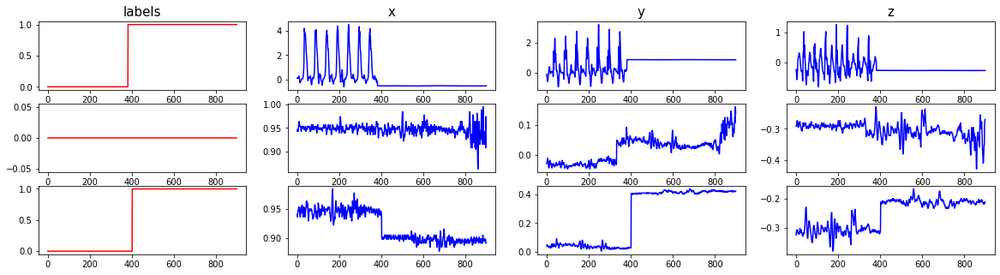

In [ ]:
fig, ax = plt.subplots(3, 4, figsize = (20, 5))

for i in range(3):
    ax[i][0].plot(supervised_train_dataset[i][1], color='red')
    for j in range(3):
        ax[i][j+1].plot(supervised_train_dataset[i][0][:, j], color='blue')

ax[0][0].set_title('labels', fontsize = 15)
ax[0][1].set_title('x', fontsize = 15)
ax[0][2].set_title('y', fontsize = 15)
ax[0][3].set_title('z', fontsize = 15)

plt.show()

In [ ]:
SEQ_LEN = 100
batch_size = 4
pos_numbers = 10
neg_numbers = 10

alpha = 0.5

model = models.SyntheticTSCPEncoder(seq_len=SEQ_LEN, c_in=3, 
                                    nb_filters=4, 
                                    code_size=8, 
                                    n_steps=4)

tscp_model = models.TSCPModelAlpha(model=model, supervised_train_dataset=supervised_train_dataset,
                                   supervised_test_dataset=supervised_test_dataset, 
                                   unsupervised_train_dataset=unsupervised_train_dataset,
                                   unsupervised_test_dataset=unsupervised_test_dataset,
                                   batch_size=batch_size, 
                                   window_1=SEQ_LEN, window_2=SEQ_LEN,
                                   pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                   alpha=alpha)

In [ ]:
seed = 0
tscp_model = train.train_model(tscp_model, experiments_name, max_epochs=100,
                               patience=5, gpus=0, seed=seed, 
                               min_delta=1e-4, 
                               monitor='train_loss_epoch',
                               check_val_every_n_epoch=2)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.458


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.457


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.452


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.446


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.438


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.430


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.415


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.032 >= min_delta = 0.0001. New best score: 0.366


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.351


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.347


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.346


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.342


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.339


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.337


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.336


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.331


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.330


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.329


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.325


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.325


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.321


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.321. Signaling Trainer to stop.


In [ ]:
_, test_dataset = datasets.CPDDatasetsNew(num=100, num_change=6,
                                         path_to_data='drive/MyDrive/data/USC-HAD',
                                         experiments_name=experiments_name).get_dataset_()
val_dataloader = DataLoader(test_dataset, batch_size=4,
                            shuffle=False, num_workers=0)

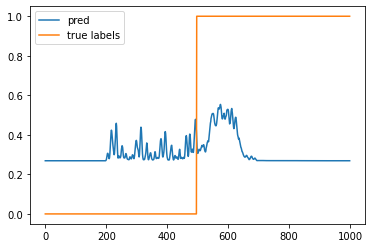

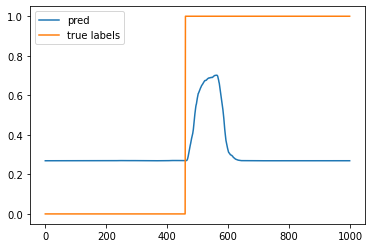

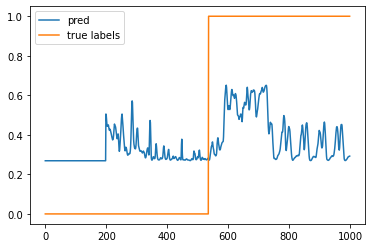

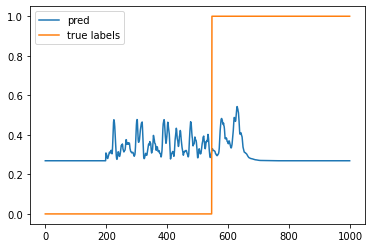

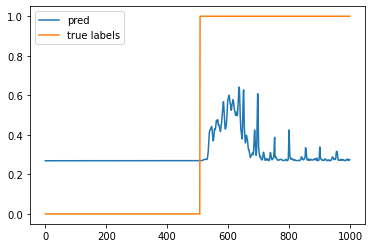

...

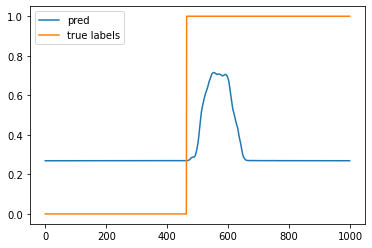

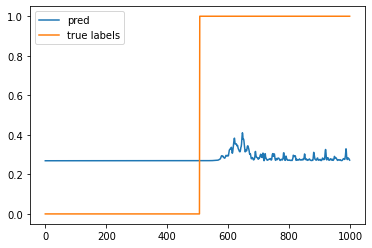

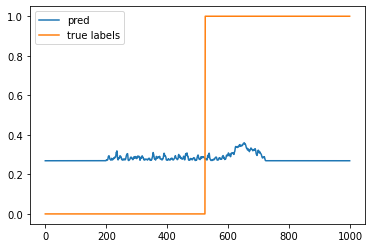

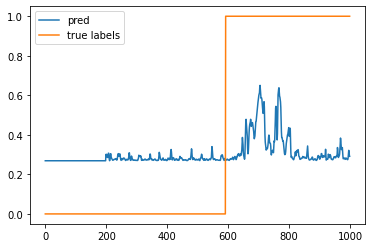

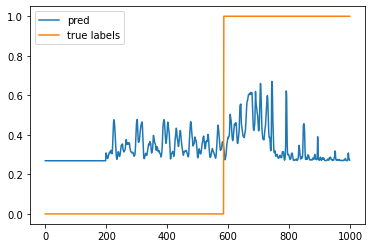

In [ ]:
#device = 'cuda:0'
device = 'cpu'
tscp_model.to(device)

for inputs, labels in val_dataloader:
    preds = tscp.get_tscp_output_2(tscp_model, inputs.to(device), window=tscp_model.window_1).detach().cpu()
    inputs.detach().cpu()
    labels.detach().cpu()
    for i in range(2):
        plt.figure()
        plt.plot(preds[i], label='pred')
        plt.plot(labels[i], label='true labels')
        plt.legend()

In [ ]:
threshold_number = 45
threshold_list = np.linspace(-5, 5, threshold_number)
threshold_list = 1 / (1 + np.exp(-threshold_list))
threshold_list = [-0.001] + list(threshold_list) + [1.001]

# cut threshold list
threshold_list = list(threshold_list)[18:27]

In [ ]:
# evaluating on original val dataset
r, delay_list, fp_delay_list = metrics.evaluation_pipeline(tscp_model,
                                                           val_dataloader,  
                                                           threshold_list, 
                                                           device='cpu', 
                                                           model_type='tscp',
                                                           verbose=True)

NameError: ignored

In [ ]:
SEQ_LEN = 100
batch_size = 4
pos_numbers = 10
neg_numbers = 10

alpha = 0.5

for supervised_num in [10, 15, 20, 25, 30]:
    for unsupervised_num in [100, supervised_num, 2 * supervised_num]:
        supervised_train_dataset, supervised_test_dataset = datasets.CPDDatasetsNew(num=supervised_num,
                                                                                    num_change=supervised_num//2,
                                                                                    path_to_data='drive/MyDrive/data/USC-HAD',
                                                                                    experiments_name=experiments_name).get_dataset_()
        unsupervised_train_dataset, unsupervised_test_dataset = datasets.CPDDatasetsNew(num=unsupervised_num,
                                                                                    num_change=unsupervised_num//2,
                                                                                    path_to_data='drive/MyDrive/data/USC-HAD',
                                                                                    experiments_name=experiments_name).get_dataset_()

        
        auc = []
        max_cover = []
        f1_score = []

        for seed in [0, 1, 2]:
            model = models.SyntheticTSCPEncoder(seq_len=SEQ_LEN, c_in=3, 
                                                nb_filters=4, 
                                                code_size=8, 
                                                n_steps=4)

            tscp_model = models.TSCPModelAlpha(model=model, supervised_train_dataset=supervised_train_dataset,
                                            supervised_test_dataset=supervised_test_dataset, 
                                            unsupervised_train_dataset=unsupervised_train_dataset,
                                            unsupervised_test_dataset=unsupervised_test_dataset,
                                            batch_size=batch_size, 
                                            window_1=SEQ_LEN, window_2=SEQ_LEN,
                                            pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                            alpha=alpha)
            
            tscp_model = train.train_model(tscp_model, experiments_name, max_epochs=100,
                                patience=5, gpus=0, seed=seed, 
                                min_delta=1e-4, 
                                monitor='train_loss_epoch',
                                check_val_every_n_epoch=2)
            
            r, delay_list, fp_delay_list = metrics.evaluation_pipeline(tscp_model,
                                                            val_dataloader,  
                                                            threshold_list, 
                                                            device='cpu', 
                                                            model_type='tscp',
                                                            verbose=False)
            
            auc.append(r[3])
            max_cover.append(r[8])
            f1_score.append(r[5])

        auc = np.array(auc)
        max_cover = np.array(max_cover)
        f1_score = np.array(f1_score)
        
        print(' ')
        print('supervised_num: ', supervised_num, 'unsupervised_num: ', unsupervised_num)
        print('auc mean: %.4f' % auc.mean(), 'auc std: %.4f' % auc.std())
        print('f1_score mean: %.4f' % f1_score.mean(), 'f1_score std: %.4f' % f1_score.std())
        print('max_cover mean: %.4f' % max_cover.mean(), 'max_cover std: %.4f' % max_cover.std())
        print('='*120)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.031 >= min_delta = 0.0001. New best score: 0.361


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.057 >= min_delta = 0.0001. New best score: 0.304


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.281


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.025 >= min_delta = 0.0001. New best score: 0.256


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.243


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.231


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.225


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.224


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.220


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.215


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.209


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.209. Signaling Trainer to stop.
100%|██████████| 9/9 [00:43<00:00,  4.78s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.027 >= min_delta = 0.0001. New best score: 0.367


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.043 >= min_delta = 0.0001. New best score: 0.324


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.028 >= min_delta = 0.0001. New best score: 0.296


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.042 >= min_delta = 0.0001. New best score: 0.253


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.234


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.232


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.232. Signaling Trainer to stop.
100%|██████████| 9/9 [00:43<00:00,  4.80s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.372


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.038 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.047 >= min_delta = 0.0001. New best score: 0.288


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.044 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.237


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.231


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.228


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.225


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.219


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.217


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.216


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.202


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.202. Signaling Trainer to stop.
100%|██████████| 9/9 [00:43<00:00,  4.87s/it]

 
supervised_num:  10 unsupervised_num:  100
auc mean: 123403.0960 auc std: 9585.3245
f1_score mean: 0.7448 f1_score std: 0.0662
max_cover mean: 0.7763 max_cover std: 0.0085



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.387


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.383


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.379


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.368


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.354


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.346


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.345


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.339


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.338


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.323


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.302


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.302. Signaling Trainer to stop.
100%|██████████| 9/9 [00:45<00:00,  5.06s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.398. Signaling Trainer to stop.
100%|██████████| 9/9 [00:45<00:00,  5.04s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.399. Signaling Trainer to stop.
100%|██████████| 9/9 [00:44<00:00,  4.96s/it]

 
supervised_num:  10 unsupervised_num:  10
auc mean: 177779.5497 auc std: 12643.6970
f1_score mean: 0.2063 f1_score std: 0.2918
max_cover mean: 0.6092 max_cover std: 0.0561



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.387


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.386


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.382


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.368


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.354


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.343


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.025 >= min_delta = 0.0001. New best score: 0.318


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.316


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.025 >= min_delta = 0.0001. New best score: 0.291


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.288


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.282


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.033 >= min_delta = 0.0001. New best score: 0.249


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.233


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.220


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.220. Signaling Trainer to stop.
100%|██████████| 9/9 [00:45<00:00,  5.08s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.379


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.375


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.369


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.367


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.348


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.326


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.034 >= min_delta = 0.0001. New best score: 0.292


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.292


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.285


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.275


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.032 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.244. Signaling Trainer to stop.
100%|██████████| 9/9 [00:46<00:00,  5.12s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.380


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.377


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.369


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.362


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.358


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.340


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.322


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.307


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.034 >= min_delta = 0.0001. New best score: 0.273


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.272


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.270


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.270


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.262


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.
100%|██████████| 9/9 [00:49<00:00,  5.45s/it]


 
supervised_num:  10 unsupervised_num:  20
auc mean: 141349.9393 auc std: 5907.4518
f1_score mean: 0.7375 f1_score std: 0.0449
max_cover mean: 0.7540 max_cover std: 0.0211


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.037 >= min_delta = 0.0001. New best score: 0.358


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.039 >= min_delta = 0.0001. New best score: 0.319


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.038 >= min_delta = 0.0001. New best score: 0.281


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.260


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.257


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.249


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.227


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.224


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.220


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.214


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.209


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.209. Signaling Trainer to stop.
100%|██████████| 9/9 [00:45<00:00,  5.02s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.387


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.371


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.348


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.030 >= min_delta = 0.0001. New best score: 0.318


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.301


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.283


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.279


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.271


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.265


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.262


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.255


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.253


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.250


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.249


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.232


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.232


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.230


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.222


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.220


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.220. Signaling Trainer to stop.
100%|██████████| 9/9 [00:45<00:00,  5.09s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.380


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.363


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.033 >= min_delta = 0.0001. New best score: 0.330


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.319


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.041 >= min_delta = 0.0001. New best score: 0.277


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.265


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.252


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.251


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.241


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.237


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.229


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.221


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.219


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.214


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.213


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.213. Signaling Trainer to stop.
100%|██████████| 9/9 [00:46<00:00,  5.11s/it]


 
supervised_num:  15 unsupervised_num:  100
auc mean: 125331.2126 auc std: 5081.7324
f1_score mean: 0.7824 f1_score std: 0.0322
max_cover mean: 0.7621 max_cover std: 0.0158


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.383


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.380


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.375


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.361


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.357


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.340


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.333


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.329


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.305


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.292


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.276


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.262


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.022 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.240. Signaling Trainer to stop.
100%|██████████| 9/9 [00:51<00:00,  5.70s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.386


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.381


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.377


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.361


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.355


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.343


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.342


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.319


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.295


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.291


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.290


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.290. Signaling Trainer to stop.
100%|██████████| 9/9 [00:51<00:00,  5.72s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.373


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.361


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.344


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.323


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.029 >= min_delta = 0.0001. New best score: 0.294


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.290


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.041 >= min_delta = 0.0001. New best score: 0.249


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.241


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.235


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.233


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.229


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.227


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.225


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.217


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.
100%|██████████| 9/9 [00:53<00:00,  5.97s/it]


 
supervised_num:  15 unsupervised_num:  15
auc mean: 138664.7709 auc std: 13124.7161
f1_score mean: 0.7185 f1_score std: 0.0895
max_cover mean: 0.7578 max_cover std: 0.0398


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.381


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.028 >= min_delta = 0.0001. New best score: 0.353


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.349


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.349


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.029 >= min_delta = 0.0001. New best score: 0.320


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.298


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.288


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.273


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.255


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.242


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.235


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.216


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.216. Signaling Trainer to stop.
100%|██████████| 9/9 [00:49<00:00,  5.51s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.375


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.360


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.337


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.029 >= min_delta = 0.0001. New best score: 0.309


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.297


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.294


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.288


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.026 >= min_delta = 0.0001. New best score: 0.262


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.253


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.241


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.223. Signaling Trainer to stop.
100%|██████████| 9/9 [00:50<00:00,  5.66s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.387


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.380


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.368


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.360


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.354


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.338


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.322


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.022 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.289


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.278


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.265


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.262


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.251


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.238. Signaling Trainer to stop.
100%|██████████| 9/9 [00:50<00:00,  5.66s/it]


 
supervised_num:  15 unsupervised_num:  30
auc mean: 136726.1331 auc std: 8137.4249
f1_score mean: 0.7310 f1_score std: 0.1005
max_cover mean: 0.7558 max_cover std: 0.0391


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.399. Signaling Trainer to stop.
100%|██████████| 9/9 [00:48<00:00,  5.36s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.369


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.035 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.030 >= min_delta = 0.0001. New best score: 0.304


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.290


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.275


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.273


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.266


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.242


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.236


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.236. Signaling Trainer to stop.
100%|██████████| 9/9 [00:48<00:00,  5.39s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.379


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.027 >= min_delta = 0.0001. New best score: 0.352


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.030 >= min_delta = 0.0001. New best score: 0.322


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.308


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.293


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.286


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.268


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.246


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.235


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.233


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.227


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.221


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.218


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.218. Signaling Trainer to stop.
100%|██████████| 9/9 [00:48<00:00,  5.40s/it]


 
supervised_num:  20 unsupervised_num:  100
auc mean: 146761.2093 auc std: 29318.1424
f1_score mean: 0.5264 f1_score std: 0.3745
max_cover mean: 0.7133 max_cover std: 0.1046


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.396


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.386


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.381


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.379


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.375


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.366


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.364


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.358


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.346


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.342


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.340


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.339


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.315


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.312


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.311


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.303


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.292


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.278


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.261


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.259


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.
100%|██████████| 9/9 [00:59<00:00,  6.64s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.399


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.382


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.378


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.365


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.349


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.336


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.322


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.311


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.307


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.300


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.025 >= min_delta = 0.0001. New best score: 0.275


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.269


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.257


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.257


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.246


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.230


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.230. Signaling Trainer to stop.
100%|██████████| 9/9 [00:57<00:00,  6.36s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.380


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.362


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.355


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.027 >= min_delta = 0.0001. New best score: 0.328


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.020 >= min_delta = 0.0001. New best score: 0.308


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.291


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.283


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.260


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.259


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.256


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.252


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.028 >= min_delta = 0.0001. New best score: 0.224


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.216


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.216. Signaling Trainer to stop.
100%|██████████| 9/9 [00:57<00:00,  6.37s/it]


 
supervised_num:  20 unsupervised_num:  20
auc mean: 134907.7463 auc std: 5406.4524
f1_score mean: 0.7273 f1_score std: 0.0580
max_cover mean: 0.7547 max_cover std: 0.0196


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.366


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.034 >= min_delta = 0.0001. New best score: 0.332


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.309


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.279


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.269


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.253


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.246


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.245


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.234


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.234


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.234. Signaling Trainer to stop.
100%|██████████| 9/9 [00:53<00:00,  5.97s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.395


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.386


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.370


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.360


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.347


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.026 >= min_delta = 0.0001. New best score: 0.322


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.313


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.309


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.287


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.284


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.283


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.267


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.254


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.246


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.246. Signaling Trainer to stop.
100%|██████████| 9/9 [00:55<00:00,  6.11s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.399


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.398


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.397


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.380


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.373


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.369


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.368


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.364


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.362


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.352


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.350


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.040 >= min_delta = 0.0001. New best score: 0.310


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.307


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.301


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.287


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.266


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.250


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.247


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.229


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.229. Signaling Trainer to stop.
100%|██████████| 9/9 [00:56<00:00,  6.31s/it]


 
supervised_num:  20 unsupervised_num:  40
auc mean: 128006.2415 auc std: 2298.0648
f1_score mean: 0.7502 f1_score std: 0.0948
max_cover mean: 0.7878 max_cover std: 0.0197


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.373


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.034 >= min_delta = 0.0001. New best score: 0.339


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.315


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.300


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.283


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.274


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.266


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.260


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.246


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.242


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.241


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.236


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.225


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.222


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.218


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.218


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.205


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.205. Signaling Trainer to stop.
100%|██████████| 9/9 [00:51<00:00,  5.69s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.386


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.362


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.034 >= min_delta = 0.0001. New best score: 0.328


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.027 >= min_delta = 0.0001. New best score: 0.301


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.283


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.278


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.261


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.259


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.248


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.229


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.226


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.224


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.224


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.224


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.215


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.212


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.212. Signaling Trainer to stop.
100%|██████████| 9/9 [00:52<00:00,  5.86s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.375


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.020 >= min_delta = 0.0001. New best score: 0.355


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.343


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.033 >= min_delta = 0.0001. New best score: 0.309


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.042 >= min_delta = 0.0001. New best score: 0.268


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.256


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.239


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.236


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.230


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.230. Signaling Trainer to stop.
100%|██████████| 9/9 [00:53<00:00,  5.91s/it]


 
supervised_num:  25 unsupervised_num:  100
auc mean: 123007.5683 auc std: 1619.8774
f1_score mean: 0.7660 f1_score std: 0.0000
max_cover mean: 0.8033 max_cover std: 0.0275


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.381


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.374


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.369


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.352


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.341


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.028 >= min_delta = 0.0001. New best score: 0.313


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.281


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.270


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.253


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.239


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.225


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.225. Signaling Trainer to stop.
100%|██████████| 9/9 [01:02<00:00,  6.96s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.386


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.378


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.372


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.366


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.348


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.331


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.322


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.277


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.271


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.260


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.255


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.241


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.237


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.224


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.220


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.211


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.210


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.204


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.202


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.198


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.
100%|██████████| 9/9 [01:07<00:00,  7.55s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.393


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.390


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.383


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.364


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.354


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.344


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.028 >= min_delta = 0.0001. New best score: 0.316


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.298


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.275


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.254


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.027 >= min_delta = 0.0001. New best score: 0.227


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.227. Signaling Trainer to stop.
100%|██████████| 9/9 [01:02<00:00,  6.95s/it]


 
supervised_num:  25 unsupervised_num:  25
auc mean: 135483.9425 auc std: 4818.5677
f1_score mean: 0.7555 f1_score std: 0.0445
max_cover mean: 0.7680 max_cover std: 0.0160


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.393


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.381


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.377


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.372


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.371


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.362


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.358


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.349


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.341


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.335


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.022 >= min_delta = 0.0001. New best score: 0.313


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.303


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.300


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.292


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.290


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.284


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.274


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.265


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.254


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.254


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.251


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.251. Signaling Trainer to stop.
100%|██████████| 9/9 [01:02<00:00,  6.94s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.382


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.374


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.362


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.351


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.327


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.314


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.284


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.283


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.282


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.258


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.251


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.248


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.234


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.228


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.228. Signaling Trainer to stop.
100%|██████████| 9/9 [01:01<00:00,  6.80s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.376


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.360


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.022 >= min_delta = 0.0001. New best score: 0.338


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.032 >= min_delta = 0.0001. New best score: 0.307


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.287


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.276


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.272


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.020 >= min_delta = 0.0001. New best score: 0.252


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.242


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.235


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.232


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.231


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.222


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.216


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.216. Signaling Trainer to stop.
100%|██████████| 9/9 [01:03<00:00,  7.00s/it]


 
supervised_num:  25 unsupervised_num:  50
auc mean: 132613.4484 auc std: 4382.5593
f1_score mean: 0.7633 f1_score std: 0.0585
max_cover mean: 0.7827 max_cover std: 0.0195


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.389


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.381


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.020 >= min_delta = 0.0001. New best score: 0.361


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.025 >= min_delta = 0.0001. New best score: 0.336


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.029 >= min_delta = 0.0001. New best score: 0.307


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.289


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.278


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.266


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.255


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.251


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.237


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.230


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.222


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.218


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.218. Signaling Trainer to stop.
100%|██████████| 9/9 [00:55<00:00,  6.17s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.386


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.383


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.382


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.379


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.376


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.369


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.022 >= min_delta = 0.0001. New best score: 0.347


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.037 >= min_delta = 0.0001. New best score: 0.310


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.037 >= min_delta = 0.0001. New best score: 0.272


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.248


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.230


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.228


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.225


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.223. Signaling Trainer to stop.
100%|██████████| 9/9 [00:56<00:00,  6.33s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.040 >= min_delta = 0.0001. New best score: 0.344


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.041 >= min_delta = 0.0001. New best score: 0.303


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.031 >= min_delta = 0.0001. New best score: 0.272


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.263


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.263


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.255


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.242


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.238. Signaling Trainer to stop.
100%|██████████| 9/9 [00:56<00:00,  6.28s/it]


 
supervised_num:  30 unsupervised_num:  100
auc mean: 122047.7630 auc std: 2507.2650
f1_score mean: 0.8074 f1_score std: 0.0309
max_cover mean: 0.7972 max_cover std: 0.0177


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.387


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.378


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.364


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.350


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.035 >= min_delta = 0.0001. New best score: 0.315


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.300


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.291


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.288


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.275


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.266


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.245


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.242


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.232


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.232. Signaling Trainer to stop.
100%|██████████| 9/9 [01:05<00:00,  7.33s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.387


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.383


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.379


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.374


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.371


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.355


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.350


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.335


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.314


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.313


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.294


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.277


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.250


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.246


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.237


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.234


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.234. Signaling Trainer to stop.
100%|██████████| 9/9 [01:12<00:00,  8.02s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.389


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.387


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.385


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.382


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.380


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.374


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.363


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.353


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.352


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.329


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.036 >= min_delta = 0.0001. New best score: 0.293


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.027 >= min_delta = 0.0001. New best score: 0.266


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.258


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.238


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.223. Signaling Trainer to stop.
100%|██████████| 9/9 [01:11<00:00,  7.90s/it]


 
supervised_num:  30 unsupervised_num:  30
auc mean: 130014.5807 auc std: 7766.0650
f1_score mean: 0.7570 f1_score std: 0.0126
max_cover mean: 0.7813 max_cover std: 0.0127


INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.377


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.365


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.342


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.326


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.023 >= min_delta = 0.0001. New best score: 0.303


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.294


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.275


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.271


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.259


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.248


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.248. Signaling Trainer to stop.
100%|██████████| 9/9 [01:02<00:00,  6.91s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.392


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.388


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.382


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.365


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.354


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.331


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.318


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.309


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.293


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.008 >= min_delta = 0.0001. New best score: 0.286


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.285


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.285. Signaling Trainer to stop.
100%|██████████| 9/9 [01:04<00:00,  7.15s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.389


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.383


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.369


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.022 >= min_delta = 0.0001. New best score: 0.347


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.032 >= min_delta = 0.0001. New best score: 0.315


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.028 >= min_delta = 0.0001. New best score: 0.287


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.018 >= min_delta = 0.0001. New best score: 0.269


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.014 >= min_delta = 0.0001. New best score: 0.255


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.243


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.242


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.218


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.213


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.212


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.210


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.201


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.201. Signaling Trainer to stop.
100%|██████████| 9/9 [01:05<00:00,  7.29s/it]

 
supervised_num:  30 unsupervised_num:  60
auc mean: 114947.1484 auc std: 36330.1674
f1_score mean: 0.7414 f1_score std: 0.0539
max_cover mean: 0.7776 max_cover std: 0.0279


In [ ]:
SEQ_LEN = 100
batch_size = 4
pos_numbers = 10
neg_numbers = 10

alpha = 0.5

for supervised_num, unsupervised_num in [(30, 100)]:
    supervised_train_dataset, supervised_test_dataset = datasets.CPDDatasetsNew(num=supervised_num,
                                                                                num_change=supervised_num//2,
                                                                                path_to_data='drive/MyDrive/data/USC-HAD',
                                                                                experiments_name=experiments_name).get_dataset_()
    unsupervised_train_dataset, unsupervised_test_dataset = datasets.CPDDatasetsNew(num=unsupervised_num,
                                                                                num_change=unsupervised_num//2,
                                                                                path_to_data='drive/MyDrive/data/USC-HAD',
                                                                                experiments_name=experiments_name).get_dataset_()

    
    auc = []
    max_cover = []
    f1_score = []

    for seed in [0, 1, 2]:
        model = models.SyntheticTSCPEncoder(seq_len=SEQ_LEN, c_in=3, 
                                            nb_filters=4, 
                                            code_size=8, 
                                            n_steps=4)

        tscp_model = models.TSCPModelAlpha(model=model, supervised_train_dataset=supervised_train_dataset,
                                        supervised_test_dataset=supervised_test_dataset, 
                                        unsupervised_train_dataset=unsupervised_train_dataset,
                                        unsupervised_test_dataset=unsupervised_test_dataset,
                                        batch_size=batch_size, 
                                        window_1=SEQ_LEN, window_2=SEQ_LEN,
                                        pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                        alpha=alpha)
        
        tscp_model = train.train_model(tscp_model, experiments_name, max_epochs=100,
                            patience=5, gpus=0, seed=seed, 
                            min_delta=1e-4, 
                            monitor='train_loss_epoch',
                            check_val_every_n_epoch=2)
        
        r, delay_list, fp_delay_list = metrics.evaluation_pipeline(tscp_model,
                                                        val_dataloader,  
                                                        threshold_list, 
                                                        device='cpu', 
                                                        model_type='tscp',
                                                        verbose=False)
        
        auc.append(r[3])
        max_cover.append(r[8])
        f1_score.append(r[5])

    auc = np.array(auc)
    max_cover = np.array(max_cover)
    f1_score = np.array(f1_score)
    
    print(' ')
    print('supervised_num: ', supervised_num, 'unsupervised_num: ', unsupervised_num)
    print('auc mean: %.4f' % auc.mean(), 'auc std: %.4f' % auc.std())
    print('f1_score mean: %.4f' % f1_score.mean(), 'f1_score std: %.4f' % f1_score.std())
    print('max_cover mean: %.4f' % max_cover.mean(), 'max_cover std: %.4f' % max_cover.std())
    print('='*120)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.378


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.084 >= min_delta = 0.0001. New best score: 0.294


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.040 >= min_delta = 0.0001. New best score: 0.254


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.252


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.247


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.244


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.231


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.230


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.223


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.223. Signaling Trainer to stop.
100%|██████████| 9/9 [00:43<00:00,  4.85s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.009 >= min_delta = 0.0001. New best score: 0.384


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.373


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.363


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.341


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.330


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.024 >= min_delta = 0.0001. New best score: 0.306


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.296


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.292


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.281


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.264


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.261


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.261


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.261. Signaling Trainer to stop.
100%|██████████| 9/9 [00:44<00:00,  4.92s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.394


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.393


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.391


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.372


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.030 >= min_delta = 0.0001. New best score: 0.342


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.019 >= min_delta = 0.0001. New best score: 0.323


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.306


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.283


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.267


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.267. Signaling Trainer to stop.
100%|██████████| 9/9 [00:44<00:00,  4.94s/it]

 
supervised_num:  30 unsupervised_num:  100
auc mean: 114402.4713 auc std: 9378.2722
f1_score mean: 0.7280 f1_score std: 0.0353
max_cover mean: 0.7785 max_cover std: 0.0213


In [ ]:
SEQ_LEN = 100
batch_size = 4
pos_numbers = 10
neg_numbers = 10

alpha = 0

auc = []
max_cover = []
f1_score = []

for seed in [3, 4, 5]:
    model = models.SyntheticTSCPEncoder(seq_len=SEQ_LEN, c_in=3, 
                                        nb_filters=4, 
                                        code_size=8, 
                                        n_steps=4)

    tscp_model = models.TSCPModelAlpha(model=model, supervised_train_dataset=supervised_train_dataset,
                                    supervised_test_dataset=supervised_test_dataset, 
                                    unsupervised_train_dataset=unsupervised_train_dataset,
                                    unsupervised_test_dataset=unsupervised_test_dataset,
                                    batch_size=batch_size, 
                                    window_1=SEQ_LEN, window_2=SEQ_LEN,
                                    pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                    alpha=alpha)
    
    tscp_model = train.train_model(tscp_model, experiments_name, max_epochs=100,
                        patience=5, gpus=0, seed=seed, 
                        min_delta=1e-4, 
                        monitor='train_loss_epoch',
                        check_val_every_n_epoch=2)
    
    r, delay_list, fp_delay_list = metrics.evaluation_pipeline(tscp_model,
                                                    val_dataloader,  
                                                    threshold_list, 
                                                    device='cpu', 
                                                    model_type='tscp',
                                                    verbose=False)
    
    auc.append(r[3])
    max_cover.append(r[8])
    f1_score.append(r[5])

auc = np.array(auc)
max_cover = np.array(max_cover)
f1_score = np.array(f1_score)

print(' ')
print('supervised_num: ', supervised_num)
print('auc mean: %.4f' % auc.mean(), 'auc std: %.4f' % auc.std())
print('f1_score mean: %.4f' % f1_score.mean(), 'f1_score std: %.4f' % f1_score.std())
print('max_cover mean: %.4f' % max_cover.mean(), 'max_cover std: %.4f' % max_cover.std())
print('='*120)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.463


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.074 >= min_delta = 0.0001. New best score: 0.389


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.029 >= min_delta = 0.0001. New best score: 0.360


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.355


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.351


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.347


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.344


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.342


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.342


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.341


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.338


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.338


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.336


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.334. Signaling Trainer to stop.

100%|██████████| 9/9 [00:35<00:00,  3.99s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.464


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.062 >= min_delta = 0.0001. New best score: 0.402


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.030 >= min_delta = 0.0001. New best score: 0.372


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.021 >= min_delta = 0.0001. New best score: 0.351


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.346


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.344


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.343


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.340


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.340


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.338


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.336


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.336


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.332


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.332


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.329


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.329


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.328


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.325


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.323


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.322


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.321


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.321


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.319


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.316


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.316


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.315


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.314


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.
100%|██████████| 9/9 [00:36<00:00,  4.09s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.460


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.059 >= min_delta = 0.0001. New best score: 0.400


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.029 >= min_delta = 0.0001. New best score: 0.371


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.012 >= min_delta = 0.0001. New best score: 0.359


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.354


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.351


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.348


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.346


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.345


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.344


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.341


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.340


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.337


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.337


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.337


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.335


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.334


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.333


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.328


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.327


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.326


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.326. Signaling Trainer to stop.
100%|██████████| 9/9 [00:36<00:00,  4.09s/it]

 
supervised_num:  30
auc mean: 103006.7653 auc std: 27349.4559
f1_score mean: 0.7656 f1_score std: 0.0423
max_cover mean: 0.7545 max_cover std: 0.0106


## FINETUNING

In [ ]:
supervised_num = 50
unsupervised_num = 250

In [ ]:
supervised_train_dataset, supervised_test_dataset = datasets.CPDDatasetsNew(num=supervised_num,
                                                                            num_change=supervised_num//2,
                                                                            path_to_data='drive/MyDrive/data/USC-HAD',
                                                                            experiments_name=experiments_name).get_dataset_()
unsupervised_train_dataset, unsupervised_test_dataset = datasets.CPDDatasetsNew(num=unsupervised_num,
                                                                                num_change=unsupervised_num//2,
                                                                                path_to_data='drive/MyDrive/data/USC-HAD',
                                                                                experiments_name=experiments_name).get_dataset_()

In [ ]:
SEQ_LEN = 100
batch_size = 4
pos_numbers = 10
neg_numbers = 10

model = models.SyntheticTSCPEncoder(seq_len=SEQ_LEN, c_in=3, 
                                    nb_filters=4, 
                                    code_size=8, 
                                    n_steps=4)

tscp_model_unsupervised = models.TSCPModelAlpha(model=model, supervised_train_dataset=supervised_train_dataset,
                                                supervised_test_dataset=supervised_test_dataset, 
                                                unsupervised_train_dataset=unsupervised_train_dataset,
                                                unsupervised_test_dataset=unsupervised_test_dataset,
                                                batch_size=batch_size, 
                                                window_1=SEQ_LEN, window_2=SEQ_LEN,
                                                pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                                alpha=1)
tscp_model_supervised = models.TSCPModelAlpha(model=tscp_model_unsupervised.model, 
                                              supervised_train_dataset=supervised_train_dataset,
                                              supervised_test_dataset=supervised_test_dataset, 
                                              unsupervised_train_dataset=unsupervised_train_dataset,
                                              unsupervised_test_dataset=unsupervised_test_dataset,
                                              batch_size=batch_size, 
                                              window_1=SEQ_LEN, window_2=SEQ_LEN,
                                              pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                              alpha=0)

In [ ]:
seed = 0
tscp_model_unsupervised = train.train_model(tscp_model_unsupervised, 
                                            experiments_name, max_epochs=100,
                                            patience=5, gpus=0, seed=seed, 
                                            min_delta=1e-4, 
                                            monitor='train_loss_epoch',
                                            check_val_every_n_epoch=2)

tscp_model_supervised = train.train_model(tscp_model_supervised, 
                                          experiments_name, max_epochs=10,
                                          patience=5, gpus=0, seed=seed, 
                                          min_delta=1e-4, 
                                          monitor='train_loss_epoch',
                                          check_val_every_n_epoch=2)

In [ ]:
_, test_dataset = datasets.CPDDatasetsNew(num=100, num_change=6,
                                         path_to_data='drive/MyDrive/data/USC-HAD',
                                         experiments_name=experiments_name).get_dataset_()
val_dataloader = DataLoader(test_dataset, batch_size=4,
                            shuffle=False, num_workers=0)

In [ ]:
threshold_number = 45
threshold_list = np.linspace(-5, 5, threshold_number)
threshold_list = 1 / (1 + np.exp(-threshold_list))
threshold_list = [-0.001] + list(threshold_list) + [1.001]

# cut threshold list
threshold_list = list(threshold_list)[18:27]

In [ ]:
# evaluating on original val dataset
device='cpu'
r, delay_list, fp_delay_list = metrics.evaluation_pipeline(tscp_model_supervised,
                                                           val_dataloader,  
                                                           threshold_list, 
                                                           device=device, 
                                                           model_type='tscp',
                                                           verbose=True)

In [ ]:
seed = 0

SEQ_LEN = 100
batch_size = 4
pos_numbers = 10
neg_numbers = 10

model = models.SyntheticTSCPEncoder(seq_len=SEQ_LEN, c_in=3, 
                                        nb_filters=4, 
                                        code_size=8, 
                                        n_steps=4)

tscp_model_unsupervised = models.TSCPModelAlpha(model=model, supervised_train_dataset=supervised_train_dataset,
                                                    supervised_test_dataset=supervised_test_dataset, 
                                                    unsupervised_train_dataset=unsupervised_train_dataset,
                                                    unsupervised_test_dataset=unsupervised_test_dataset,
                                                    batch_size=batch_size, 
                                                    window_1=SEQ_LEN, window_2=SEQ_LEN,
                                                    pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                                    alpha=1)

tscp_model_unsupervised = train.train_model(tscp_model_unsupervised, 
                                            experiments_name, max_epochs=100,
                                            patience=5, gpus=0, seed=seed, 
                                            min_delta=1e-4, 
                                            monitor='train_loss_epoch',
                                            check_val_every_n_epoch=2)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.312


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.017 >= min_delta = 0.0001. New best score: 0.295


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.055 >= min_delta = 0.0001. New best score: 0.240


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.045 >= min_delta = 0.0001. New best score: 0.195


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.032 >= min_delta = 0.0001. New best score: 0.163


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.157


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.152


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.137


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.005 >= min_delta = 0.0001. New best score: 0.132


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.006 >= min_delta = 0.0001. New best score: 0.126


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.122


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.003 >= min_delta = 0.0001. New best score: 0.120


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.010 >= min_delta = 0.0001. New best score: 0.109


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.011 >= min_delta = 0.0001. New best score: 0.098


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.098


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.094


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.016 >= min_delta = 0.0001. New best score: 0.078


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.013 >= min_delta = 0.0001. New best score: 0.065


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.061


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.057


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.055


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.015 >= min_delta = 0.0001. New best score: 0.040


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.040. Signaling Trainer to stop.


In [ ]:
device='cpu'
r, delay_list, fp_delay_list = metrics.evaluation_pipeline(tscp_model_unsupervised,
                                                           val_dataloader,  
                                                           threshold_list, 
                                                           device=device, 
                                                           model_type='tscp',
                                                           verbose=False)
print('\n F1-Score: ', r[5])
r

100%|██████████| 9/9 [00:45<00:00,  5.03s/it]


 F1-Score:  0.5641025641025641


(0.5,
 469.3333435058594,
 142.56666564941406,
 86396.8043235949,
 (2, 12, 5, 11),
 0.5641025641025641,
 0.6685064757472333,
 0.3882805885928385,
 0.6763050654747975)

In [ ]:
y = []
err = []
for max_epochs in [0, 1, 2, 3, 4, 5, 10, 15, 20]:
  auc = []
  max_cover = []
  f1_score = []

  for seed in [0, 1, 2]:
    tscp_model_supervised = models.TSCPModelAlpha(model=tscp_model_unsupervised.model, 
                                                  supervised_train_dataset=supervised_train_dataset,
                                                  supervised_test_dataset=supervised_test_dataset, 
                                                  unsupervised_train_dataset=unsupervised_train_dataset,
                                                  unsupervised_test_dataset=unsupervised_test_dataset,
                                                  batch_size=batch_size, 
                                                  window_1=SEQ_LEN, window_2=SEQ_LEN,
                                                  pos_numbers=pos_numbers, neg_numbers=neg_numbers, 
                                                  alpha=0)

    tscp_model_supervised = train.train_model(tscp_model_supervised, 
                                          experiments_name, max_epochs=max_epochs,
                                          patience=5, gpus=0, seed=seed, 
                                          min_delta=1e-4, 
                                          monitor='train_loss_epoch',
                                          check_val_every_n_epoch=2)
    
    r, delay_list, fp_delay_list = metrics.evaluation_pipeline(tscp_model_supervised,
                                                           val_dataloader,  
                                                           threshold_list, 
                                                           device=device, 
                                                           model_type='tscp',
                                                           verbose=False)
    auc.append(r[3])
    max_cover.append(r[8])
    f1_score.append(r[5])

  auc = np.array(auc)
  max_cover = np.array(max_cover)
  f1_score = np.array(f1_score)

  y.append(f1_score.mean())
  err.append(f1_score.std())

  print('max_epoch: ', max_epochs)
  print('auc mean: %.4f' % auc.mean(), 'auc std: %.4f' % auc.std())
  print('f1_score mean: %.4f' % f1_score.mean(), 'f1_score std: %.4f' % f1_score.std())
  print('max_cover mean: %.4f' % max_cover.mean(), 'max_cover std: %.4f' % max_cover.std())
  print('='*120)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=0` reached.
100%|██████████| 9/9 [00:46<00:00,  5.20s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=0` reached.
100%|██████████| 9/9 [00:46<00:00,  5.12s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=0` reached.
100%|██████████| 9/9 [00:46<00:00,  5.12s/it]

max_epoch:  0
auc mean: 86396.8043 auc std: 0.0000
f1_score mean: 0.5641 f1_score std: 0.0000
max_cover mean: 0.6763 max_cover std: 0.0000



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.
100%|██████████| 9/9 [00:47<00:00,  5.32s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.
100%|██████████| 9/9 [00:45<00:00,  5.03s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=1` reached.
100%|██████████| 9/9 [00:45<00:00,  5.08s/it]

max_epoch:  1
auc mean: 64230.3237 auc std: 17504.6523
f1_score mean: 0.5641 f1_score std: 0.0000
max_cover mean: 0.6979 max_cover std: 0.0011



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.331
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=2` reached.
100%|██████████| 9/9 [00:46<00:00,  5.21s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.327
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=2` reached.
100%|██████████| 9/9 [00:46<00:00,  5.20s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.323
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=2` reached.
100%|██████████| 9/9 [00:49<00:00,  5.52s/it]

max_epoch:  2
auc mean: 68085.0473 auc std: 471.8791
f1_score mean: 0.5761 f1_score std: 0.0169
max_cover mean: 0.7029 max_cover std: 0.0004



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.325
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=3` reached.
100%|██████████| 9/9 [00:46<00:00,  5.17s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.320
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=3` reached.
100%|██████████| 9/9 [00:46<00:00,  5.21s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.317
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=3` reached.
100%|██████████| 9/9 [00:48<00:00,  5.34s/it]

max_epoch:  3
auc mean: 50392.7935 auc std: 12566.8392
f1_score mean: 0.6000 f1_score std: 0.0000
max_cover mean: 0.7116 max_cover std: 0.0064



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.320


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.318
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=4` reached.
100%|██████████| 9/9 [00:46<00:00,  5.16s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.313


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=4` reached.
100%|██████████| 9/9 [00:47<00:00,  5.23s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.311


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=4` reached.
100%|██████████| 9/9 [00:45<00:00,  5.10s/it]

max_epoch:  4
auc mean: 29664.0904 auc std: 4626.1722
f1_score mean: 0.5951 f1_score std: 0.0069
max_cover mean: 0.6968 max_cover std: 0.0003



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.313


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.313
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=5` reached.
100%|██████████| 9/9 [00:45<00:00,  5.04s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.308


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.308
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=5` reached.
100%|██████████| 9/9 [00:47<00:00,  5.25s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.307


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=5` reached.
100%|██████████| 9/9 [00:48<00:00,  5.35s/it]

max_epoch:  5
auc mean: 30991.3480 auc std: 4626.3089
f1_score mean: 0.5927 f1_score std: 0.0405
max_cover mean: 0.6941 max_cover std: 0.0049



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.310


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.310


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.303


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
100%|██████████| 9/9 [00:56<00:00,  6.26s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.306


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.305


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.305


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
100%|██████████| 9/9 [00:54<00:00,  6.02s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.305


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.303


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.302
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=10` reached.
100%|██████████| 9/9 [00:59<00:00,  6.60s/it]

max_epoch:  10
auc mean: 29931.9841 auc std: 1803.5675
f1_score mean: 0.6344 f1_score std: 0.0126
max_cover mean: 0.7102 max_cover std: 0.0094



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.307


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.300


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
100%|██████████| 9/9 [00:54<00:00,  6.07s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.304


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.303


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.302


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
100%|██████████| 9/9 [00:53<00:00,  5.94s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.302


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.000 >= min_delta = 0.0001. New best score: 0.302


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.300


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=15` reached.
100%|██████████| 9/9 [00:54<00:00,  6.03s/it]

max_epoch:  15
auc mean: 27547.6654 auc std: 987.8803
f1_score mean: 0.6348 f1_score std: 0.0131
max_cover mean: 0.7191 max_cover std: 0.0075



INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.305


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.007 >= min_delta = 0.0001. New best score: 0.298


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.298. Signaling Trainer to stop.
100%|██████████| 9/9 [00:58<00:00,  6.55s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.302


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.301


Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.001 >= min_delta = 0.0001. New best score: 0.300


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.004 >= min_delta = 0.0001. New best score: 0.297


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.
100%|██████████| 9/9 [01:01<00:00,  6.82s/it]
INFO:pytorch_lightning.utilities.rank_zero:GPU available: False, used: False
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.callbacks.model_summary:
  | Name  | Type                 | Params
-----------------------------------------------
0 | model | SyntheticTSCPEncoder | 4.4 K 
-----------------------------------------------
4.4 K     Trainable params
0         Non-trainable params
4.4 K     Total params
0.018     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved. New best score: 0.301


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Metric train_loss_epoch improved by 0.002 >= min_delta = 0.0001. New best score: 0.299


Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

INFO:pytorch_lightning.callbacks.early_stopping:Monitored metric train_loss_epoch did not improve in the last 5 records. Best score: 0.299. Signaling Trainer to stop.
INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=20` reached.
100%|██████████| 9/9 [00:58<00:00,  6.53s/it]

max_epoch:  20
auc mean: 30002.4105 auc std: 3518.6473
f1_score mean: 0.6341 f1_score std: 0.0000
max_cover mean: 0.7319 max_cover std: 0.0039


In [ ]:
y

[0.5641025641025641,
 0.5641025641025641,
 0.576068376068376,
 0.6,
 0.5951219512195122,
 0.5927350427350427,
 0.6343979868370112,
 0.6347855837362361,
 0.6341463414634146]

In [ ]:
l_250 = [0.6829268292682927,
 0.6829268292682927,
 0.6975393674202524,
 0.7075061448288902,
 0.7632135306553911,
 0.7441860465116279,
 0.7441860465116279,
 0.748062015503876,
 0.7813953488372093]

In [ ]:
l_100 = [0.7142857142857143,
 0.6496124031007752,
 0.5974295974295974,
 0.6403133903133903,
 0.6178861788617885,
 0.6813953488372092,
 0.6719512195121952,
 0.8134498480243161,
 0.8167848699763592]

In [ ]:
l_50 = [0.5641025641025641,
 0.5641025641025641,
 0.576068376068376,
 0.6,
 0.5951219512195122,
 0.5927350427350427,
 0.6343979868370112,
 0.6347855837362361,
 0.6341463414634146]

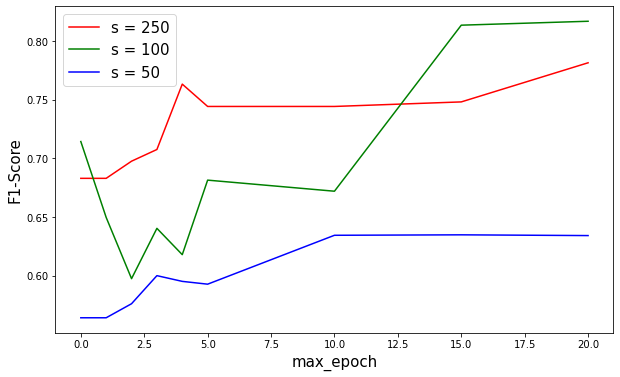

In [ ]:
s = [0, 1, 2, 3, 4, 5, 10, 15, 20]
plt.figure(figsize=(10, 6))

plt.plot(s, l_250, color='red', label='s = 250')
plt.plot(s, l_100, color='green', label='s = 100')
plt.plot(s, l_50, color='blue', label='s = 50')

plt.xlabel('max_epoch', fontsize=15)
plt.ylabel('F1-Score', fontsize=15)

#plt.errorbar(s, y, yerr=err, fmt=' ',capsize=4, elinewidth=1, ecolor='blue', label = 'Standard deviation')

plt.legend(fontsize=15)

plt.show()